In [ ]:
import pandas as pd
import numpy as np

components= pd.read_csv(r"C:\Users\shras\Desktop\project\COMPONENTS_PUBLIC.csv",low_memory=False)
injuries= pd.read_csv(r"C:\Users\shras\Desktop\project\INJURIES_PUBLIC.csv",low_memory=False)
occurrence= pd.read_csv(r"C:\Users\shras\Desktop\project\OCCURRENCE_PUBLIC.csv",low_memory=False)
train= pd.read_csv(r"C:\Users\shras\Desktop\project\TRAIN_PUBLIC.csv",low_memory=False)

FileNotFoundError: [Errno 2] No such file or directory: 'C:\\Users\\shras\\Desktop\\project\\COMPONENTS_PUBLIC.csv'

In [ ]:
#merging the dataset
merged_df = components.merge(injuries, on='OccID', how='outer', suffixes=('', '_injuries'))
merged_df = merged_df.merge(occurrence, on='OccID', how='outer', suffixes=('', '_occurrence'))
merged_df = merged_df.merge(train, on='OccID', how='outer', suffixes=('', '_train'))

In [ ]:
# Handling duplicate columns
for col in merged_df.columns:
    if '_injuries' in col or '_occurrence' in col or '_train' in col:
        original_col = col.split('_')[0]
        if original_col in merged_df.columns:
            merged_df[original_col] = merged_df[original_col].combine_first(merged_df[col])
        merged_df.drop(columns=[col], inplace=True)

In [ ]:
print(merged_df.dtypes)

OccNo                            object
OccID                             int64
ComponentSeq                    float64
SuspectedComponentFailureIND    float64
TestPerformedIND                float64
                                 ...   
RSPassengerMinorInjuries        float64
TotalRSPassengerInjuries        float64
OtherFatalInjuries              float64
OtherSeriousInjuries            float64
OtherMinorInjuries              float64
Length: 504, dtype: object


In [ ]:
merged_df.isnull().sum()

OccNo                               0
OccID                               0
ComponentSeq                    73670
SuspectedComponentFailureIND    73947
TestPerformedIND                74292
                                ...  
RSPassengerMinorInjuries          211
TotalRSPassengerInjuries          211
OtherFatalInjuries                211
OtherSeriousInjuries              211
OtherMinorInjuries                211
Length: 504, dtype: int64

In [ ]:
#Removing french columns
french_columns = [col for col in merged_df.columns if "Fre" in col]
len(french_columns)

91

In [ ]:
final_dataset=merged_df.drop(columns=french_columns)

In [ ]:
final_dataset['Class1No'] = final_dataset['Class1No'].replace(r'^\s*$', pd.NA, regex=True)

In [ ]:
# Checking the number of duplicates based on the 'OccID' column
num_duplicates = final_dataset.duplicated(subset='OccID').sum()

print(f"Number of duplicates based on OccID: {num_duplicates}")

Number of duplicates based on OccID: 12277


In [ ]:
final_dataset

,OccNo,OccID,ComponentSeq,SuspectedComponentFailureIND,TestPerformedIND,PartNameID,PartNameID_DisplayEng,Manufacturer,Model,TrainSeq,...,EmployeeFatalInjuries,EmployeeSeriousInjuries,EmployeeMinorInjuries,RSPassengerFatalInjuries,RSPassengerSeriousInjuries,RSPassengerMinorInjuries,TotalRSPassengerInjuries,OtherFatalInjuries,OtherSeriousInjuries,OtherMinorInjuries
0,R15T0302,122705,1.0,1.0,0.0,36.0,BODY BOLSTER,TRINITY,NaN,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,R15T0300,122703,1.0,1.0,0.0,36.0,BODY BOLSTER,TRINITY,NaN,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,R15T0164,121813,1.0,1.0,0.0,34.0,"BEARING, ROLLER",NaN,NaN,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,R15T0164,121813,1.0,1.0,0.0,34.0,"BEARING, ROLLER",NaN,NaN,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,R15T0164,121813,1.0,1.0,0.0,34.0,"BEARING, ROLLER",NaN,NaN,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
74835,R91C0105,42123,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
74836,R91C0105,42123,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
74837,R91C0105,42123,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
74838,R91C0105,42123,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# Dropping duplicates based on the 'OccID' column
final_dataset = final_dataset.drop_duplicates(subset='OccID')

In [ ]:
final_dataset.shape

(62563, 413)

In [ ]:
# For the exploration, we are going to consider last 20 years of the values.

df = final_dataset[(final_dataset['OccYear'] >= 2004) & (final_dataset['OccYear'] <= 2024)]

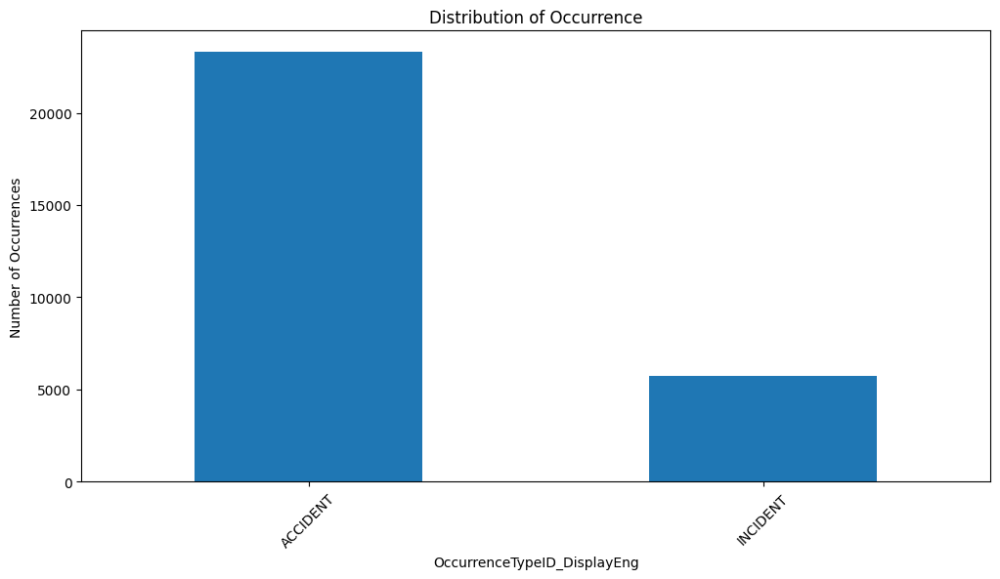

In [ ]:
import matplotlib.pyplot as plt

# Setting up data for bar graphs
columns_to_plot = ['OccurrenceTypeID_DisplayEng']

for column in columns_to_plot:
    # Count occurrences for each category
    value_counts = df[column].value_counts()

    # Plotting the bar chart
    plt.figure(figsize=(12, 6))
    value_counts.plot(kind='bar')
    plt.title(f'Distribution of Occurrence')
    plt.xlabel(column)
    plt.ylabel('Number of Occurrences')
    plt.xticks(rotation=45)
    plt.show()

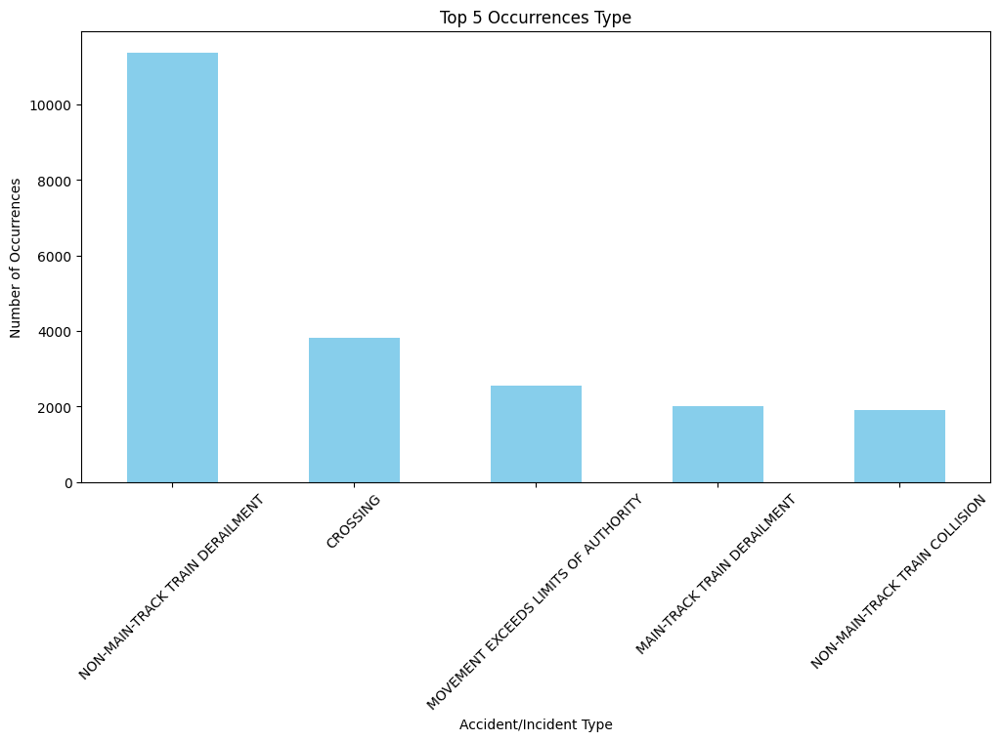

In [ ]:
acc_inc_counts = df['AccIncTypeID_DisplayEng'].value_counts().head(5)

# Plotting the bar chart for the top 5
plt.figure(figsize=(12, 6))
acc_inc_counts.plot(kind='bar', color='skyblue')
plt.title('Top 5 Occurrences Type')
plt.xlabel('Accident/Incident Type')
plt.ylabel('Number of Occurrences')
plt.xticks(rotation=45)
plt.show()

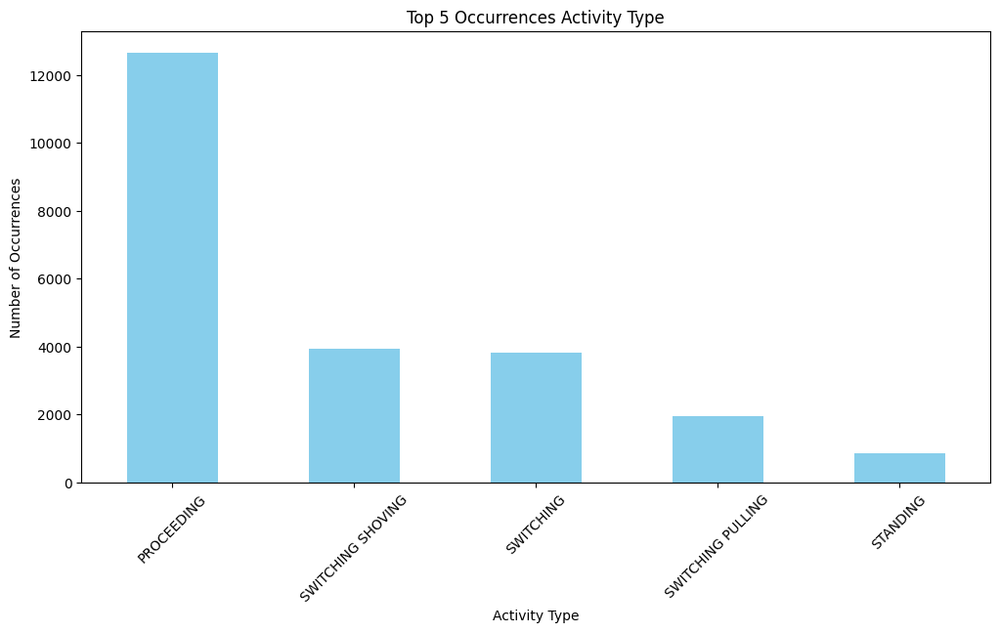

In [ ]:
counts = df['ActivityTypeID_DisplayEng'].value_counts().head(5)

# Plotting the bar chart for the top 5
plt.figure(figsize=(12, 6))
counts.plot(kind='bar', color='skyblue')
plt.title('Top 5 Occurrences Activity Type')
plt.xlabel('Activity Type')
plt.ylabel('Number of Occurrences')
plt.xticks(rotation=45)
plt.show()

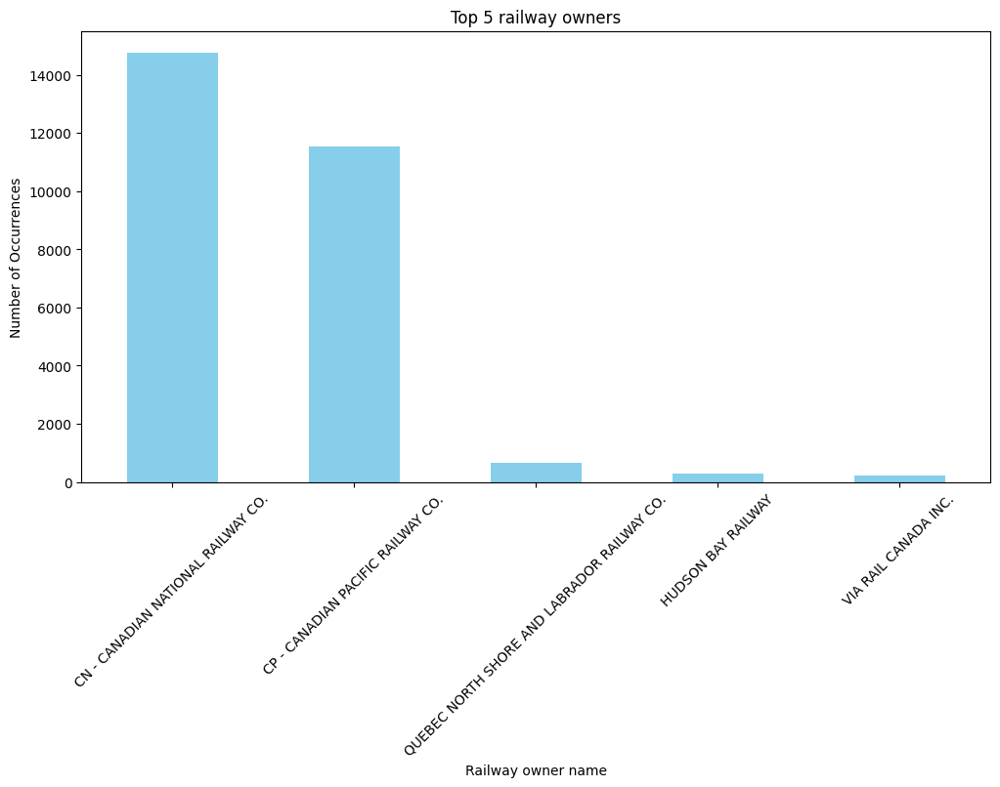

In [ ]:
counts_owner = df['SubdOwnerID_DisplayEng'].value_counts().head(5)

# Plotting the bar chart for the top 5
plt.figure(figsize=(12, 6))
counts_owner.plot(kind='bar', color='skyblue')
plt.title('Top 5 railway owners')
plt.xlabel('Railway owner name')
plt.ylabel('Number of Occurrences')
plt.xticks(rotation=45)
plt.show()

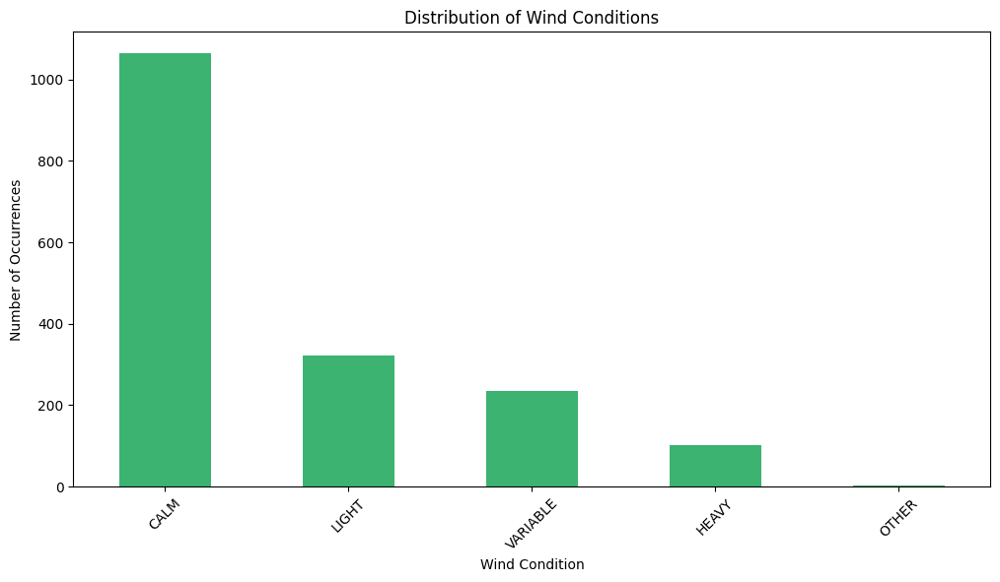

In [ ]:
# Extracting and plotting all occurrences of 'WindID_DisplayEng'
wind_counts = df['WindID_DisplayEng'].value_counts()
plt.figure(figsize=(12, 6))
wind_counts.plot(kind='bar', color='mediumseagreen')
plt.title('Distribution of Wind Conditions')
plt.xlabel('Wind Condition')
plt.ylabel('Number of Occurrences')
plt.xticks(rotation=45)
plt.show()


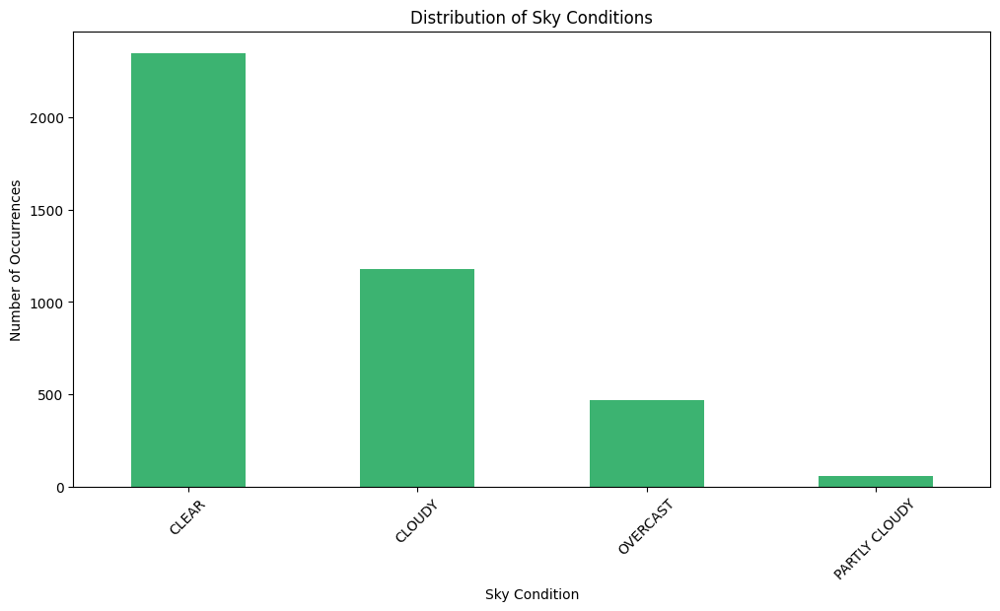

In [ ]:
sky_counts = df['SkyConditionID_DisplayEng'].value_counts()
plt.figure(figsize=(12, 6))
sky_counts.plot(kind='bar', color='mediumseagreen')
plt.title('Distribution of Sky Conditions')
plt.xlabel('Sky Condition')
plt.ylabel('Number of Occurrences')
plt.xticks(rotation=45)
plt.show()



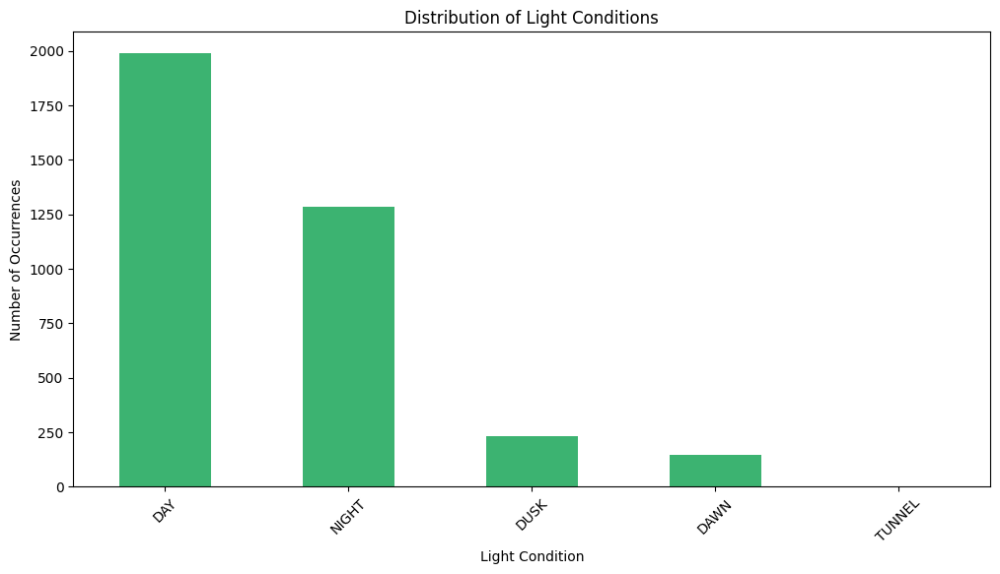

In [ ]:
light_counts = df['LightConditionID_DisplayEng'].value_counts()
plt.figure(figsize=(12, 6))
light_counts.plot(kind='bar', color='mediumseagreen')
plt.title('Distribution of Light Conditions')
plt.xlabel('Light Condition')
plt.ylabel('Number of Occurrences')
plt.xticks(rotation=45)
plt.show()


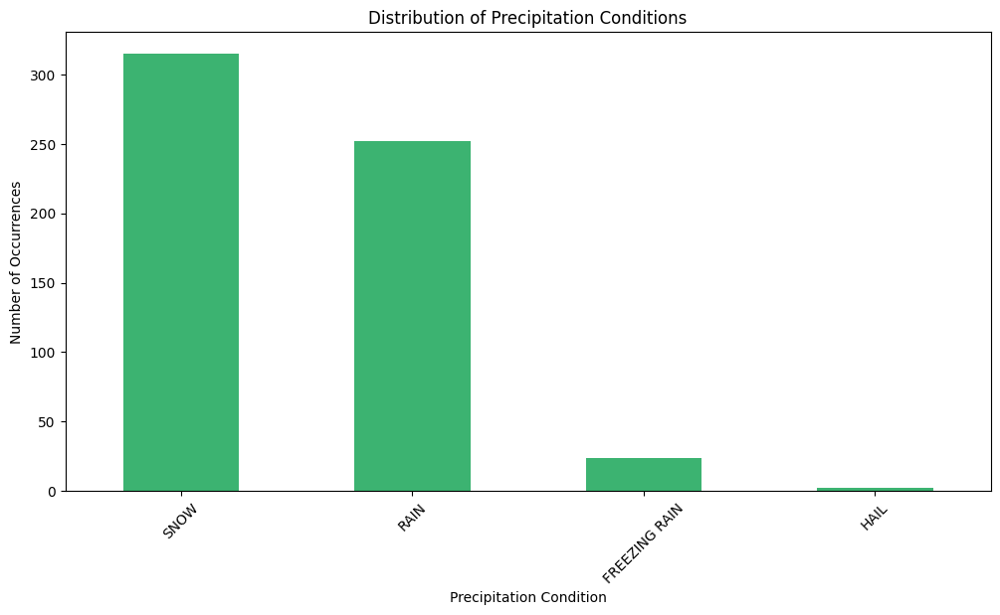

In [ ]:
Prec_counts = df['PrecipitationTypeID_DisplayEng'].value_counts()
plt.figure(figsize=(12, 6))
Prec_counts.plot(kind='bar', color='mediumseagreen')
plt.title('Distribution of Precipitation Conditions')
plt.xlabel('Precipitation Condition')
plt.ylabel('Number of Occurrences')
plt.xticks(rotation=45)
plt.show()


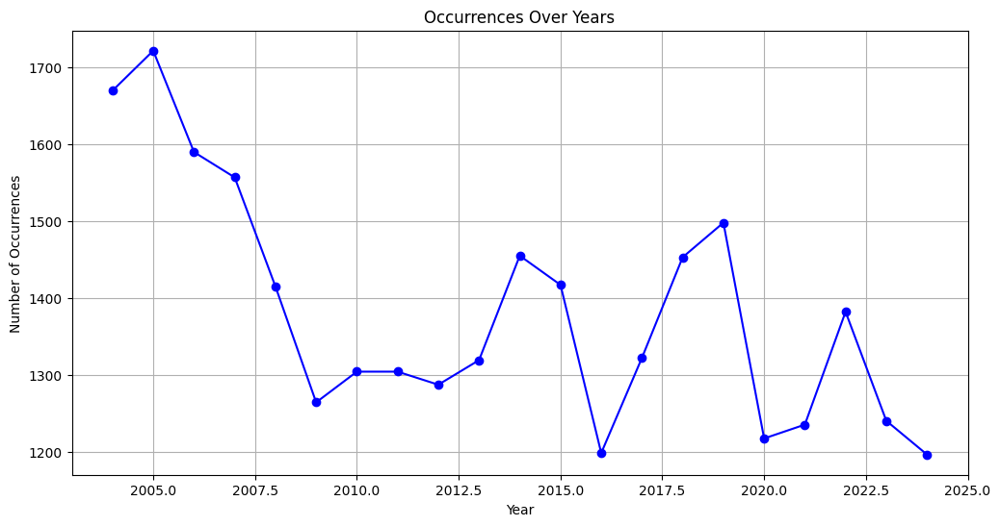

In [ ]:
# Aggregating occurrences by 'OccYear' for a line graph
occurrences_by_year = df['OccYear'].value_counts().sort_index()



# Plotting the line graph for occurrences over years with customized x-axis ticks
plt.figure(figsize=(12, 6))
occurrences_by_year.plot(kind='line', marker='o', linestyle='-', color='blue')
plt.title('Occurrences Over Years')
plt.xlabel('Year')
plt.ylabel('Number of Occurrences')
plt.grid(True)
plt.show()


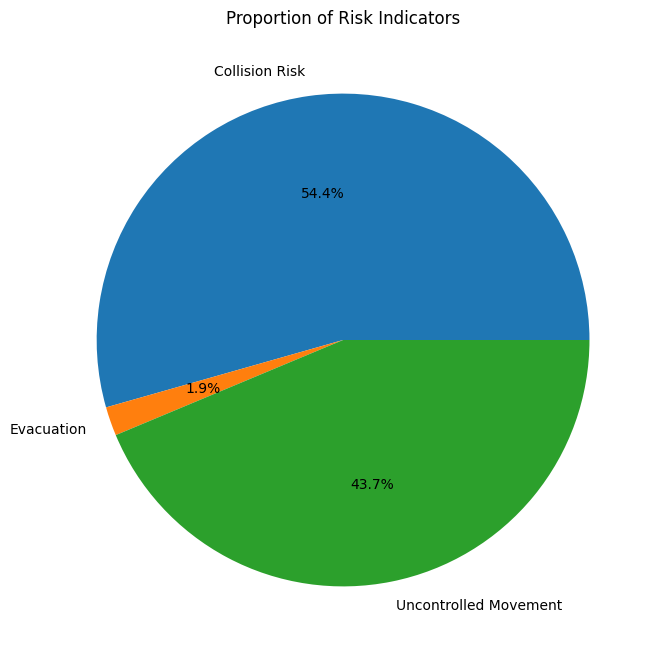

In [ ]:
# Pie chart for risk indicators
risk_data = df[['RiskOfCollisionIND', 'EvacuationIND', 'UncontrolledMovementRSIND']].sum()

plt.figure(figsize=(8, 8))
risk_data.plot(kind='pie', autopct='%1.1f%%', labels=['Collision Risk', 'Evacuation', 'Uncontrolled Movement'])
plt.title('Proportion of Risk Indicators')
plt.ylabel('')
plt.show()


# Geo Spatial Analysis

In [3]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

# Define the function for DMS to DD conversion
def dms_to_dd_bulk(column):
    degrees = column // 10000
    minutes = (column % 10000) // 100
    seconds = column % 100
    return degrees + minutes / 60 + seconds / 3600

# Convert Latitude and Longitude to decimal degrees
df.loc[:, "Latitude"] = pd.to_numeric(dms_to_dd_bulk(df["Latitude"]), errors="coerce")
df.loc[:, "Longitude"] = pd.to_numeric(dms_to_dd_bulk(df["Longitude"]), errors="coerce")

# Drop invalid or missing coordinates
df = df.dropna(subset=["Latitude", "Longitude"])
df = df[(df["Latitude"].between(-90, 90)) & (df["Longitude"].between(-180, 180))]

# Adjust longitudes for Western Hemisphere (if necessary)
df.loc[df['Longitude'] > 0, 'Longitude'] = -df['Longitude']

# Load GeoJSON dataset for Canada provinces
url = "https://raw.githubusercontent.com/codeforamerica/click_that_hood/master/public/data/canada.geojson"
provinces_gdf = gpd.read_file(url)

# Convert accidents DataFrame to GeoDataFrame
accidents_gdf = gpd.GeoDataFrame(
    df,
    geometry=[Point(xy) for xy in zip(df["Longitude"], df["Latitude"])],
    crs="EPSG:4326"
)

# Perform spatial join to assign accidents to provinces
accidents_by_province = gpd.sjoin(accidents_gdf, provinces_gdf, how="inner", predicate="intersects")

# Count accidents by province
province_accident_counts = accidents_by_province.groupby("name").size().reset_index(name="Accident_Count")

# Merge accident counts into provinces GeoDataFrame
provinces_gdf = provinces_gdf.merge(
    province_accident_counts,
    left_on="name",
    right_on="name",
    how="left"
).fillna({"Accident_Count": 0})

In [6]:
pip install adjustText

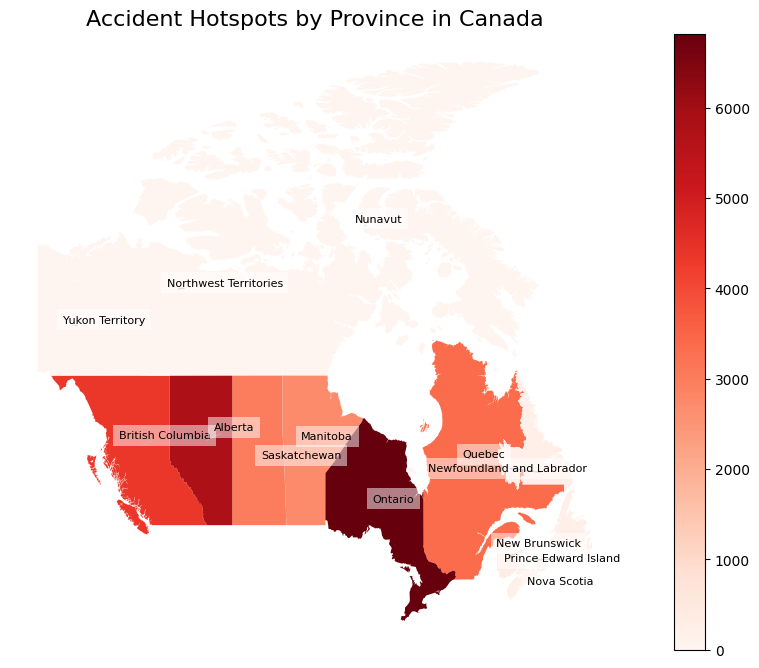

In [4]:
from adjustText import adjust_text

# Plot accident density by province
fig, ax = plt.subplots(1, 1, figsize=(14, 8))
provinces_gdf.plot(
    column="Accident_Count",
    cmap="Reds",
    legend=True,
    ax=ax
)

# Prepare text annotations for province names
texts = []
for idx, row in provinces_gdf.iterrows():
    centroid = row["geometry"].centroid
    texts.append(ax.text(
        centroid.x, centroid.y,
        row["name"],
        fontsize=8,
        ha="center",
        color="black",
        bbox=dict(facecolor='white', alpha=0.5, edgecolor='none')
    ))

# Adjust text to minimize overlaps
adjust_text(
    texts,
    arrowprops=dict(arrowstyle="-", color="gray", alpha=0.5)
)

# Title and axis adjustments
ax.set_title("Accident Hotspots by Province in Canada", fontsize=16)
plt.axis("off")
plt.show()

In [6]:
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster
from IPython.display import HTML

# Load the uploaded GeoJSON file
cities_gdf = gpd.read_file("/content/export.geojson")

# Filter dataset to include only points within Canada's boundaries
canada_df = df[
    (df["Latitude"].between(41.7, 83.1)) &  # Latitude range for Canada
    (df["Longitude"].between(-141, -52.6))  # Longitude range for Canada
]

# Create a Folium map centered on Canada
map_canada = folium.Map(location=[56.1304, -106.3468], zoom_start=4)

# Add a marker cluster
marker_cluster = MarkerCluster().add_to(map_canada)

# Add each accident as a marker in the cluster
for _, row in canada_df.iterrows():
    folium.Marker(
        location=[row["Latitude"], row["Longitude"]],
        tooltip=f"Location: {row['RegionOfOccurrence_DisplayEng']}"
    ).add_to(marker_cluster)

# Display the map
HTML(map_canada._repr_html_())
